In [ ]:
# To transform your features into new values
from sklearn import preprocessing

# Import train_test_split function
from sklearn.model_selection import train_test_split

# To construct and plot decision trees
from sklearn import tree
from matplotlib import pyplot as plt

# Import Decision Tree Classifier to predict loan approval status
from sklearn.tree import DecisionTreeClassifier

# Import Decision Tree Regressor to predict maximum loan amount
from sklearn.tree import DecisionTreeRegressor


#To optimise the Decision Tree model's hyperparameters
from sklearn.model_selection import GridSearchCV

#Import scikit-learn metrics module for classification and regression performance metrics
from sklearn import metrics

# To create and plot the confusion matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

# To produce the classification metrics report
from sklearn.metrics import classification_report

# To create, calculate and plot the RoC curve
from sklearn.metrics import RocCurveDisplay

In [ ]:
import pandas as pd

In [ ]:
data = pd.read_csv('/content/loan_approval_data.csv')

In [ ]:
# To expand the truncation of rows and columns
pd.set_option('display.max_rows', 3000)
pd.set_option('display.max_columns', 3000)
pd.set_option('display.width', 150)

# To expand e scientific notation
pd.set_option('display.float_format', '{:.2f}'.format)


In [ ]:
data.shape

(58645, 13)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58645 entries, 0 to 58644
Data columns (total 13 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       58645 non-null  int64  
 1   age                      58639 non-null  float64
 2   income                   58645 non-null  int64  
 3   home_ownership           58645 non-null  object 
 4   emplyment_length         58645 non-null  int64  
 5   loan_intent              58645 non-null  object 
 6   loan_amount              58645 non-null  int64  
 7   loan_interest_rate       58634 non-null  float64
 8   loan_income_ratio        58645 non-null  float64
 9   payment_default_on_file  58640 non-null  object 
 10  credit_history_length    58645 non-null  int64  
 11  loan_approval_status     58645 non-null  int64  
 12  max_allowed_loan         58645 non-null  int64  
dtypes: float64(3), int64(7), object(3)
memory usage: 5.8+ MB


In [ ]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,58645.00,NaN,NaN,NaN,29322.00,16929.50,0.00,14661.00,29322.00,43983.00,58644.00
age,58639.00,NaN,NaN,NaN,27.55,6.03,20.00,23.00,26.00,30.00,123.00
income,58645.00,NaN,NaN,NaN,64046.17,37931.11,4200.00,42000.00,58000.00,75600.00,1900000.00
home_ownership,58645,4,RENT,30594,NaN,NaN,NaN,NaN,NaN,NaN,NaN
emplyment_length,58645.00,NaN,NaN,NaN,4.70,4.00,0.00,2.00,4.00,7.00,150.00
loan_intent,58645,6,EDUCATION,12271,NaN,NaN,NaN,NaN,NaN,NaN,NaN
loan_amount,58645.00,NaN,NaN,NaN,9217.56,5563.81,500.00,5000.00,8000.00,12000.00,35000.00
loan_interest_rate,58634.00,NaN,NaN,NaN,10.68,3.04,-11.14,7.88,10.75,12.99,23.22
loan_income_ratio,58645.00,NaN,NaN,NaN,0.16,0.09,0.00,0.09,0.14,0.21,0.83
payment_default_on_file,58640,2,N,49940,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
import plotly.express as px

In [ ]:
loan_approval_status_fig = px.histogram(data, x='loan_approval_status')
loan_max_amount_fig = px.histogram(data, x='max_allowed_loan')
loan_approval_status_fig.show()
loan_max_amount_fig.show()


In [ ]:
Age_fig = px.box(data, x='age')
Age_fig.show()

In [ ]:
Income_fig = px.box(data, x='income')
Income_fig.show()

In [ ]:
emp_fig = px.box(data, x='emplyment_length')
emp_fig.show()

In [ ]:
loan_fig = px.box(data, x='loan_amount')
loan_fig.show()

In [ ]:
interest_fig = px.box(data, x='loan_interest_rate')
interest_fig.show()

In [ ]:
income_fig = px.box(data, x='loan_income_ratio')
income_fig.show()

In [ ]:
creHis_fig = px.box(data, x='credit_history_length')
creHis_fig.show()

In [ ]:
max_fig = px.box(data, x='max_allowed_loan')
max_fig.show()

In [ ]:
data.isna().sum()/len(data)*100

,0
id,0.00
age,0.01
income,0.00
home_ownership,0.00
emplyment_length,0.00
loan_intent,0.00
loan_amount,0.00
loan_interest_rate,0.02
loan_income_ratio,0.00
payment_default_on_file,0.01


In [ ]:
print('home_ownership categories are:', data['home_ownership'].unique())
print('loan_intent categories are:',data['loan_intent'].unique())
print('payment_default_on_file categories are:',data['payment_default_on_file'].unique())


home_ownership categories are: ['OWN' 'RENT' 'MORTGAGE' 'OTHER']
loan_intent categories are: ['EDUCATION' 'MEDICAL' 'HOMEIMPROVEMENT' 'VENTURE' 'DEBTCONSOLIDATION'
 'PERSONAL']
payment_default_on_file categories are: ['N' 'Y' nan]


In [ ]:
#Create a function to find the outlier data points
def find_outliers_IQR(data):
  q1=data.quantile(0.25)
  q3=data.quantile(0.75)
  IQR=q3-q1
  outliers = data[((data<(q1-1.5*IQR)) | (data>(q3+1.5*IQR)))]
  return outliers


In [ ]:
# Find the outlier data points in the age variable
age_outliers = find_outliers_IQR(data['age'])
print("number of outliers: "+ str(len(age_outliers)))
print("max outlier value: "+ str(age_outliers.max()))
print("min outlier value: "+ str(age_outliers.min()))
age_outliers.sort_values(ascending=False)

number of outliers: 2446
max outlier value: 123.0
min outlier value: 41.0


,age
39792,123.00
56540,84.00
54600,84.00
8728,80.00
8727,80.00
8726,76.00
25687,73.00
8725,73.00
15263,73.00
36007,70.00


In [ ]:
# Find the outlier data points in emplyment_length variable
emplyment_length_outliers = find_outliers_IQR(data['emplyment_length'])
print("number of outliers: "+ str(len(emplyment_length_outliers)))
print("max outlier value: "+ str(emplyment_length_outliers.max()))
print("min outlier value: "+ str(emplyment_length_outliers.min()))
emplyment_length_outliers.sort_values(ascending=False)

number of outliers: 1275
max outlier value: 150
min outlier value: 15


,emplyment_length
9479,150
6008,123
56728,123
37054,41
44566,41
48831,39
37571,35
51756,31
8573,31
33088,31


In [ ]:
# Find the outlier data points in loan_interest_rate variable
loan_interest_rate_outliers = find_outliers_IQR(data['loan_interest_rate'])
print("number of outliers: "+ str(len(loan_interest_rate_outliers)))
print("max outlier value: "+ str(loan_interest_rate_outliers.max()))
print("min outlier value: "+ str(loan_interest_rate_outliers.min()))
loan_interest_rate_outliers.sort_values(ascending=True)

number of outliers: 35
max outlier value: 23.22
min outlier value: -11.14


,loan_interest_rate
8998,-11.14
10845,20.69
50909,20.69
3198,20.69
4234,20.80
4232,20.86
2837,20.86
35364,20.89
6303,20.89
2842,20.89


In [ ]:
# Find the outlier data points in max_allowed_loan variable
max_allowed_loan_outliers = find_outliers_IQR(data['max_allowed_loan'])
print("number of outliers: "+ str(len(max_allowed_loan_outliers)))
print("max outlier value: "+ str(max_allowed_loan_outliers.max()))
print("min outlier value: "+ str(max_allowed_loan_outliers.min()))
max_allowed_loan_outliers.sort_values(ascending=True)

number of outliers: 2233
max outlier value: 2638778
min outlier value: -2426900


,max_allowed_loan
0,-2426900
1,-111739
2,-89000
56415,174791
56416,174817
56417,174945
56418,174953
56419,174953
56420,174958
56421,174963


In [ ]:
data.drop(data.index[[39792, 9479, 6008, 56728, 8998, 0, 1, 2]], inplace=True)

In [ ]:
age_fig = px.box(data, x='age')
emplyment_length_fig = px.box(data, x='emplyment_length')
loan_interest_rate_fig = px.box(data, x='loan_interest_rate')
max_allowed_loan_fig = px.box(data, x='max_allowed_loan')

age_fig.show()
emplyment_length_fig.show()
loan_interest_rate_fig.show()
max_allowed_loan_fig.show()

In [ ]:
# Import label encoder
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()

# Encode the categories in each object variable to a numeric form
data['home_ownership']= label_encoder.fit_transform(data['home_ownership'])
data['loan_intent']= label_encoder.fit_transform(data['loan_intent'])
data['payment_default_on_file']= label_encoder.fit_transform(data['payment_default_on_file'])

# Check the categories' labels after the label encoding transformation is completed
print("New labels for home_ownership are: ", data['home_ownership'].unique())
print("New labels for loan_intent are: ", data['loan_intent'].unique())
print("New labels for payment_default_on_file are: ", data['payment_default_on_file'].unique())


New labels for home_ownership are:  [3 0 2 1]
New labels for loan_intent are:  [1 2 5 0 4 3]
New labels for payment_default_on_file are:  [0 1 2]


In [ ]:
# Calculate the mean of each variable
Mean_age = data['age'].mean()
Mean_loan_interest_rate = data['loan_interest_rate'].mean()

# use the mean to impute the missing values in each variable
data['age'].fillna(Mean_age, inplace=True)
data['loan_interest_rate'].fillna(Mean_loan_interest_rate, inplace=True)

<ipython-input-34-42a0238689cf>:6: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-34-42a0238689cf>:7: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[

In [ ]:
data.isna().sum()/len(data)*100

,0
id,0.00
age,0.00
income,0.00
home_ownership,0.00
emplyment_length,0.00
loan_intent,0.00
loan_amount,0.00
loan_interest_rate,0.00
loan_income_ratio,0.00
payment_default_on_file,0.00


In [ ]:
data.to_csv(r'/content/prepared_loan_approval_data.csv', index=False)

In [ ]:
#Load your prepared dataset as df
df = pd.read_csv('/content/prepared_loan_approval_data.csv')

# Keep the target for classification and drop only the regression target max_allowed_loan
df.drop('max_allowed_loan',axis=1, inplace=True)
df.head()

,id,age,income,home_ownership,emplyment_length,loan_intent,loan_amount,loan_interest_rate,loan_income_ratio,payment_default_on_file,credit_history_length,loan_approval_status
0,19180,40.00,182004,3,3,1,35000,8.00,0.19,0,11,0
1,28072,40.00,90000,0,3,2,35000,12.42,0.39,0,14,0
2,32074,40.00,131004,0,9,5,30000,7.90,0.23,0,13,0
3,7224,40.00,150000,0,9,0,25000,11.89,0.17,0,11,0
4,14471,40.00,132000,0,3,2,25000,16.82,0.22,0,17,0


In [ ]:
#Save your classification dataset under the name loan_approval_status_data
df.to_csv(r'/content/loan_approval_status_data.csv', index=False)

In [ ]:
#load your fully prepared dataset as df2
df2=pd.read_csv('/content/prepared_loan_approval_data.csv')

# Filter approved applicants (loan_approval_status for status = 0) in a new data frame called approved_loan_applicants
approved_loan_applicants =  df2[(df2.loan_approval_status < 1)]

# Check the basic stats to observe only approved applicants remain
approved_loan_applicants.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,50288.00,29377.31,16930.54,0.00,14734.75,29396.50,44020.25,58644.00
age,50288.00,27.55,5.96,20.00,23.00,26.00,30.00,84.00
income,50288.00,66675.95,39309.70,4200.00,45000.00,60000.00,80000.00,1900000.00
home_ownership,50288.00,1.54,1.46,0.00,0.00,2.00,3.00,3.00
emplyment_length,50288.00,4.86,3.91,0.00,2.00,4.00,7.00,41.00
loan_intent,50288.00,2.55,1.73,0.00,1.00,3.00,4.00,5.00
loan_amount,50288.00,8888.05,5326.99,500.00,5000.00,8000.00,12000.00,35000.00
loan_interest_rate,50288.00,10.26,2.83,5.42,7.51,10.39,12.42,22.11
loan_income_ratio,50288.00,0.15,0.08,0.00,0.08,0.13,0.20,0.63
payment_default_on_file,50288.00,0.12,0.33,0.00,0.00,0.00,0.00,2.00


In [ ]:
# Drop the loan_approval_status variable from the data frame
approved_loan_applicants.drop('loan_approval_status',axis=1, inplace=True)
approved_loan_applicants.head()

<ipython-input-40-f5471eed7f8c>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,id,age,income,home_ownership,emplyment_length,loan_intent,loan_amount,loan_interest_rate,loan_income_ratio,payment_default_on_file,credit_history_length,max_allowed_loan
0,19180,40.00,182004,3,3,1,35000,8.00,0.19,0,11,35000
1,28072,40.00,90000,0,3,2,35000,12.42,0.39,0,14,35000
2,32074,40.00,131004,0,9,5,30000,7.90,0.23,0,13,30000
3,7224,40.00,150000,0,9,0,25000,11.89,0.17,0,11,25000
4,14471,40.00,132000,0,3,2,25000,16.82,0.22,0,17,25000


In [ ]:
df_loan_status = pd.read_csv('/content/loan_approval_status_data.csv')
df_loan_status.head()


,id,age,income,home_ownership,emplyment_length,loan_intent,loan_amount,loan_interest_rate,loan_income_ratio,payment_default_on_file,credit_history_length,loan_approval_status
0,19180,40.00,182004,3,3,1,35000,8.00,0.19,0,11,0
1,28072,40.00,90000,0,3,2,35000,12.42,0.39,0,14,0
2,32074,40.00,131004,0,9,5,30000,7.90,0.23,0,13,0
3,7224,40.00,150000,0,9,0,25000,11.89,0.17,0,11,0
4,14471,40.00,132000,0,3,2,25000,16.82,0.22,0,17,0


In [ ]:
 # The inputs are all the variables in the data assigned to X except the target and id, hence dropped
X = df_loan_status.drop(['loan_approval_status', 'id'], axis=1)

# The target output is assigned to y
y = df_loan_status['loan_approval_status']

# Split the dataset in 60% Training and 40% Test with class stratification
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=43, stratify=y)

In [ ]:
# Build a fully grown decision tree clf
clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)

#To make predictions on the test set, ues the predict method:
y_pred_clf = clf.predict(X_test)

#You can size your plot then plot the fully grown classification tree
Unpruned_Tree_figure = plt.figure(figsize=(200,200))
DT_Graph = tree.plot_tree(clf, feature_names=list(X_train.columns), class_names = ['0','1'], filled=True)

In [ ]:
# To find the full depth of the decision tree
print(clf.tree_.max_depth)

35


In [ ]:
#To save the DT graph
Unpruned_Tree_figure.savefig("fully_grown_decistion_tree.svg")

In [ ]:
# Create Decision Tree classifer object
clf_pruned = DecisionTreeClassifier(max_depth = 4)

# Train Decision Tree Classifer
clf_pruned = clf_pruned.fit(X_train,y_train)

#Predict the response for test dataset
y_pred_clf_pruned = clf_pruned.predict(X_test)

#You can size your plot then plot the pruned classification tree
pruned_Tree_figure = plt.figure(figsize=(200,200))
DT_Graph = tree.plot_tree(clf_pruned, feature_names=list(X_train.columns), class_names = ['0','1'], filled=True)

#To save the pruned DT graph
pruned_Tree_figure.savefig("pruned_decistion_tree.png")

clf fully grown tree report 
               precision    recall  f1-score   support

           0       0.95      0.94      0.95     20115
           1       0.67      0.70      0.68      3340

    accuracy                           0.91     23455
   macro avg       0.81      0.82      0.82     23455
weighted avg       0.91      0.91      0.91     23455



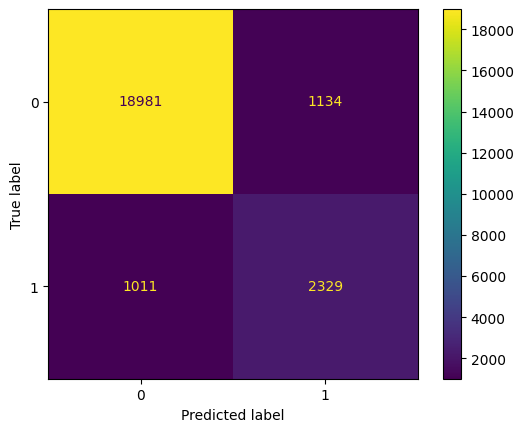

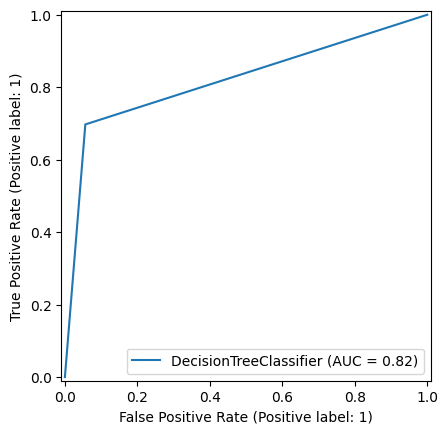

In [ ]:
# Construct and plot the confusion matrix for the fuly-grown tree (clf model)
clf_cm_test = confusion_matrix(y_test, y_pred_clf, labels=clf.classes_ )
disp = ConfusionMatrixDisplay(clf_cm_test,display_labels=clf.classes_   )
disp.plot(values_format = '.0f') # value_format = .0f expands the scientific notation e inside the confusion matrix

# Produce the classification report for the fuly-grown tree (clf model)
print("clf fully grown tree report \n", classification_report(y_test, y_pred_clf))

# Plot the ROC curve for the fully-grown treen
clf_Roc = RocCurveDisplay.from_estimator(clf, X_test, y_test)

clf_pruned tree report 
               precision    recall  f1-score   support

           0       0.93      0.99      0.96     20115
           1       0.90      0.58      0.70      3340

    accuracy                           0.93     23455
   macro avg       0.92      0.78      0.83     23455
weighted avg       0.93      0.93      0.92     23455



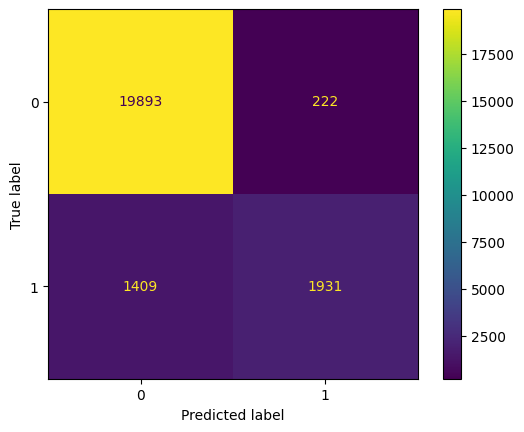

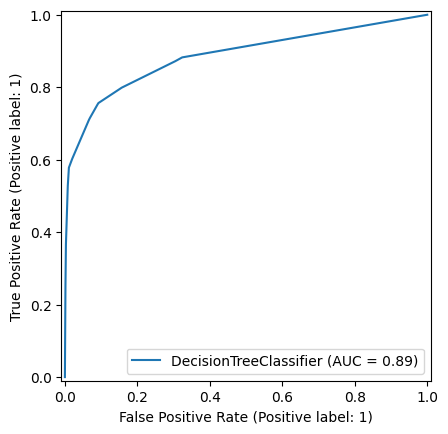

In [ ]:
# Construct and plot the confusion matrix for the pruned tree (clf_pruned model)
clf_pruned_cm_test = confusion_matrix(y_test, y_pred_clf_pruned, labels = clf_pruned.classes_)
disp = ConfusionMatrixDisplay(clf_pruned_cm_test,display_labels = clf_pruned.classes_)
disp.plot(values_format = '.0f')

# Produce the classification report for the prunded tree (clf_pruned model)
print("clf_pruned tree report \n", classification_report(y_test, y_pred_clf_pruned))

# Plot the ROC curve for the pruned treen
clf_pruned_Roc = RocCurveDisplay.from_estimator(clf_pruned, X_test, y_test)

In [ ]:
#testttt